In [5]:
import copy
import socket
import os
import pickle 
# import ssm #need to/ keep 
import sys
import glob
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap


sys.path.append("/Users/friederikebuck/Desktop/MBL/project/WholeBrainImagingAnalysis/collab/")
sys.path.append('/Users/bennetsakelaris/Documents/Obsidian Vault/Worms/wormcode/Code+Notes 09-24-24/collab/')

from scipy.ndimage import gaussian_filter1d
from get_data.read_neuro_beh_data import get_exp_features, load_json
from get_data.process_neural_data import get_derivative_of_neural_activity, get_neural_activity_from_labels, get_neural_activity_and_labels
from beh_classification.behavior_features import get_behavior_features
from beh_classification.get_behavior_classifications import get_behavior_classification
# from beh_classification.beh_classification_utils import get_start_end_is_of_ones_in_binary_array

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import balanced_accuracy_score
from sklearn.decomposition import PCA
from sklearn import svm
from sklearn.svm import LinearSVC
from sklearn.neighbors import NearestNeighbors

from load_data_fncs import load_all_data, get_exp_dates
from analyse_rslds_utils import make_behavior_decoder, input_slds

# Load data, model, behavior decoder

In [6]:


T = 1599
full_traces, full_neural_labels, full_beh_classification, full_beh_data = load_all_data()

velocity_og = np.array([full_beh_data[i]["velocity"][0:1599] for i in range(len(full_beh_data))])
acceleration_og = np.array([full_beh_data[i]["acceleration"][1:1600] for i in range(len(full_beh_data))])
head_curvature_og = np.array([full_beh_data[i]["head_angle"][0:1599] for i in range(len(full_beh_data))])
worm_curvature_og = np.array([full_beh_data[i]["worm_curvature"][0:1599] for i in range(len(full_beh_data))])
pumping_og = np.array([full_beh_data[i]["pumping"][0:1599] for i in range(len(full_beh_data))])
body_angle_mag_og = np.array([full_beh_data[i]["body_angle_mag"][0:1599] for i in range(len(full_beh_data))])
midlines_og =  np.array([full_beh_data[i]["midlines"][0:1599] for i in range(len(full_beh_data))])
body_angles_og =  np.array([full_beh_data[i]["body_angles"][0:1599] for i in range(len(full_beh_data))])

velocity = copy.deepcopy(velocity_og)
acceleration = copy.deepcopy(acceleration_og)
head_curvature = copy.deepcopy(head_curvature_og)
worm_curvature = copy.deepcopy(worm_curvature_og)
pumping = copy.deepcopy(pumping_og)
body_angle_mag =copy.deepcopy(body_angle_mag_og)
midlines =copy.deepcopy( midlines_og)
body_angles = copy.deepcopy(body_angles_og)


np.random.seed(0)

foldername = "/Users/friederikebuck/Downloads/worm notes/processed_checkpts/test_rslds_QM_run_061325/model_selection/top_2_combined/"
items = np.array(os.listdir(foldername))
folders = np.array(["." not in directory for directory in items], dtype=bool)
folders = items[folders]

folder = folders[0]

with open(foldername+"/Y.npy", 'rb') as handle:  
    Y = pickle.load(handle)


with open(foldername+folder+"/saved_data/prior.npy", 'rb') as handle:
    global_worm = pickle.load(handle)
    global_worm.D = int(global_worm.D)

with open(foldername+folder+"/saved_data/prior_q.npy", 'rb') as handle:
    q = pickle.load(handle)
    

slds = global_worm

neural_labels = np.load(foldername+"/neurons.npy", allow_pickle=True)

# set up a single behavioral state array ("z" in the language of scott): 
z = [beh_classification["is_fwd"][0:1599]+ 2*beh_classification["is_rev"][0:1599]+ 4*beh_classification["is_pause"][0:1599]+3*beh_classification["is_turn"][0:1599]-1 for beh_classification in full_beh_classification]

# get estimated latents, states
q_x = q.mean_continuous_states
q_z = [slds.most_likely_states(q_x[w], Y[w]) for w in range(len(q_x))]

# traces, neural_labels, behavior_classification, mask = load_all_data_but_pretend_its_all_one_worm()

# velocity = np.array([full_beh_data[i]["velocity"][0:1599] for i in range(len(full_beh_data))])
# # velocity_all = 
# acceleration = np.array([full_beh_data[i]["acceleration"][1:1600] for i in range(len(full_beh_data))])
# head_curvature = np.array([full_beh_data[i]["head_angle"][0:1599] for i in range(len(full_beh_data))])
# worm_curvature = np.array([full_beh_data[i]["worm_curvature"][0:1599] for i in range(len(full_beh_data))])
# pumping = np.array([full_beh_data[i]["pumping"][0:1599] for i in range(len(full_beh_data))])

q_z_all = np.concatenate(q_z)
z_all = np.concatenate(z)

# Input rSLDS
input_list = ["AVA", "RIB", "RIM", "AIB"]
new_slds, input_dict = input_slds(slds,neural_labels, input_list, input_list)
new_slds.D = int(new_slds.D)
input_dict

beh_decoder = make_behavior_decoder(q_x, z)



Worm 0, date: 2022-06-14-01
Worm 1, date: 2023-01-23-08
Worm 2, date: 2022-06-28-07
Worm 3, date: 2022-07-15-12
Worm 4, date: 2023-01-19-01
Worm 5, date: 2022-08-02-01
Worm 6, date: 2022-06-14-07
Worm 7, date: 2022-06-28-01
Worm 8, date: 2023-01-23-15
Worm 9, date: 2022-07-26-01
Worm 10, date: 2023-01-19-15
Worm 11, date: 2023-03-07-01
Worm 12, date: 2022-06-14-13
Worm 13, date: 2023-01-23-21
Worm 14, date: 2023-01-19-22
Worm 15, date: 2023-01-23-01
Worm 16, date: 2023-01-17-01
Worm 17, date: 2022-07-20-01
Worm 18, date: 2023-01-09-28
Worm 19, date: 2023-01-19-08
Worm 20, date: 2022-07-15-06


/var/folders/8z/xy4sl8b90qnc_x9p_4psrnmh0000gn/T/ipykernel_1089/1032266644.py:21: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(2*n_sections,1, figsize=(18,6*n_sections))


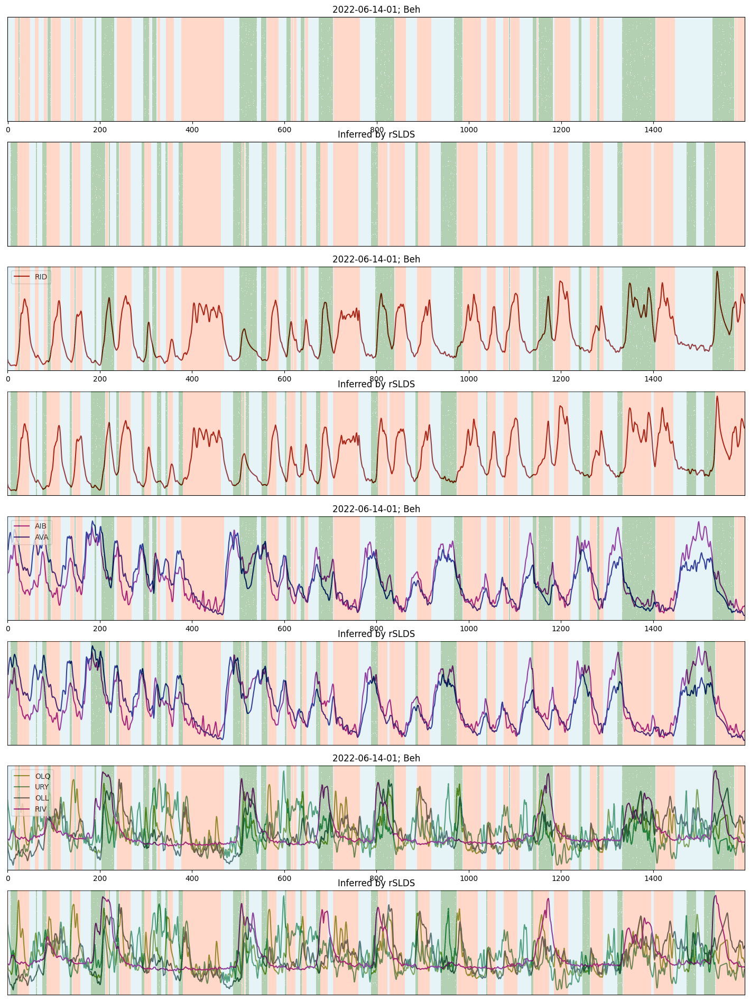

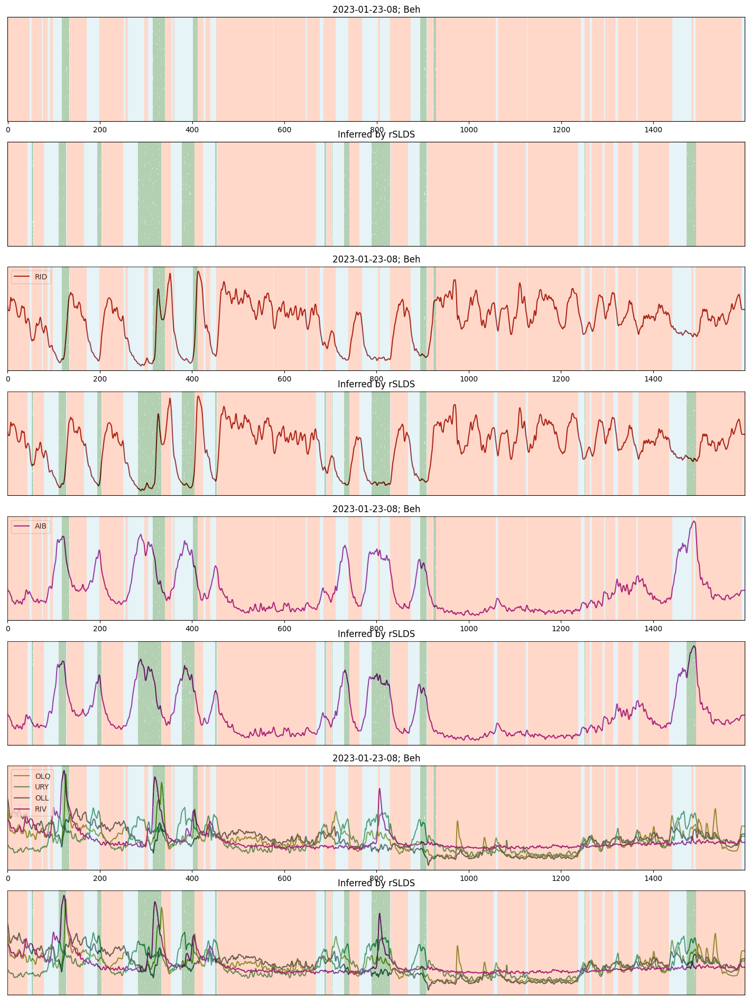

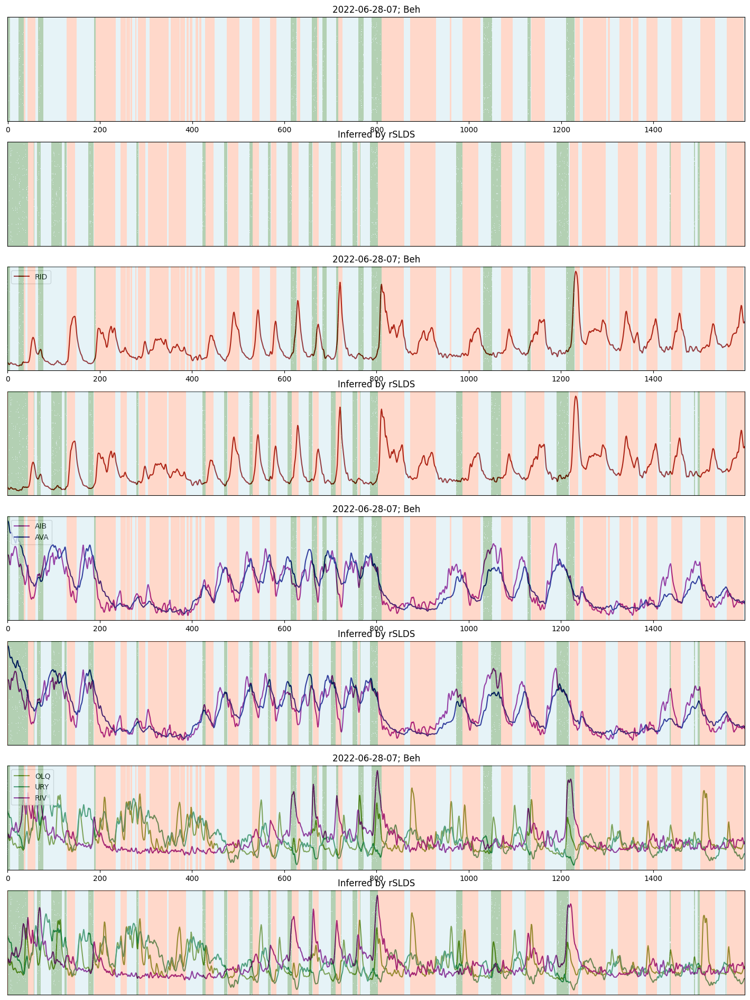

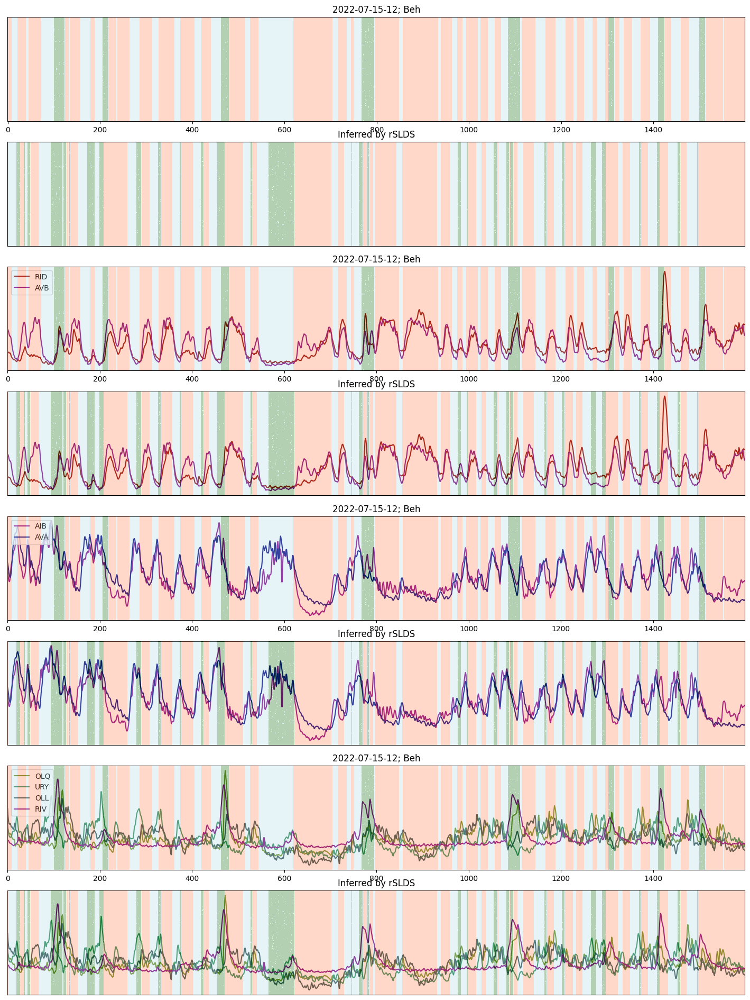

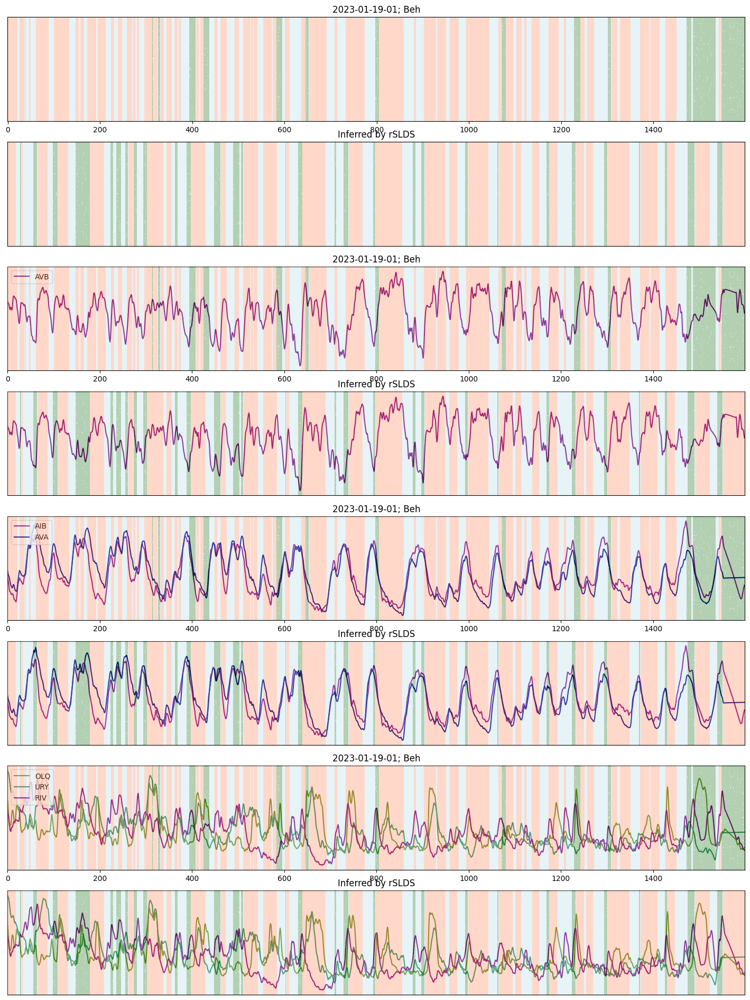

...

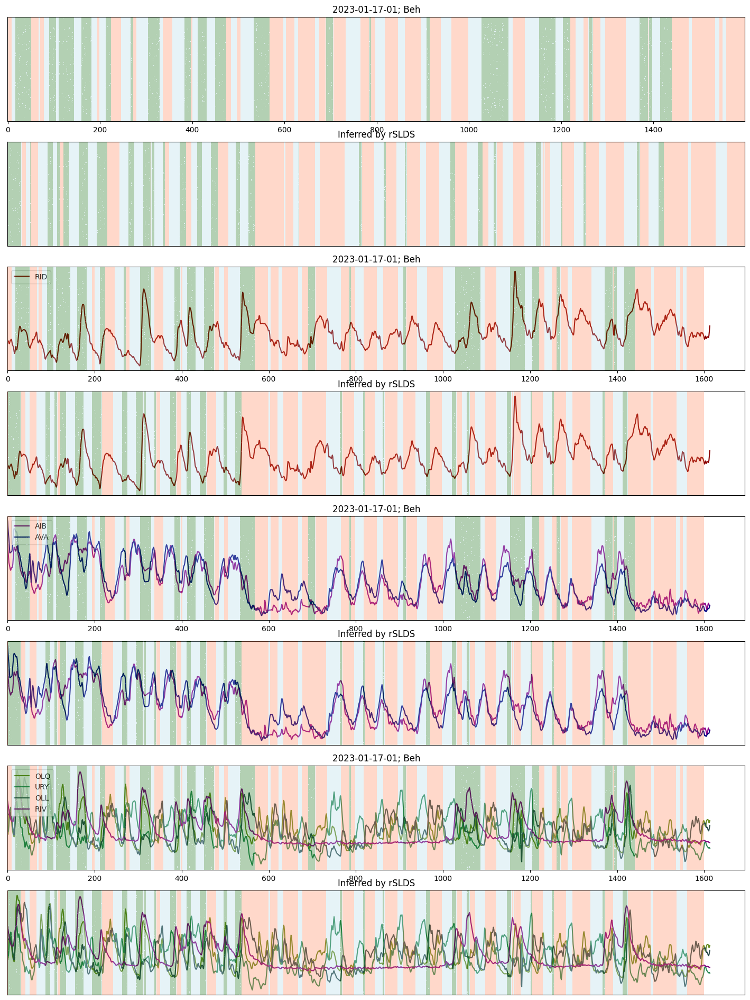

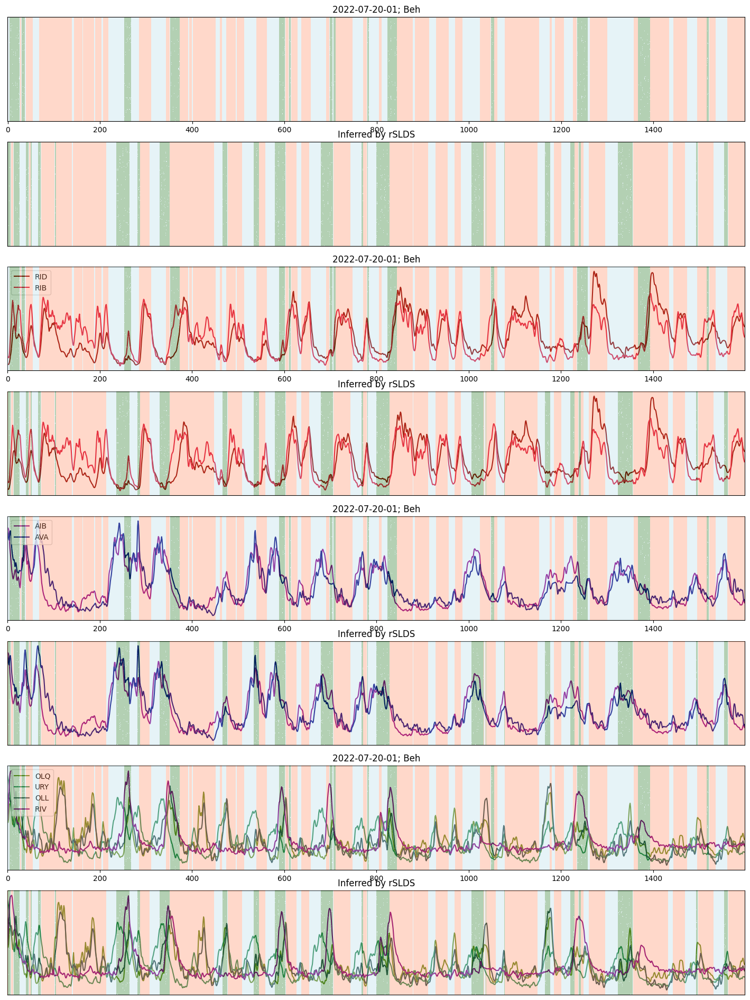

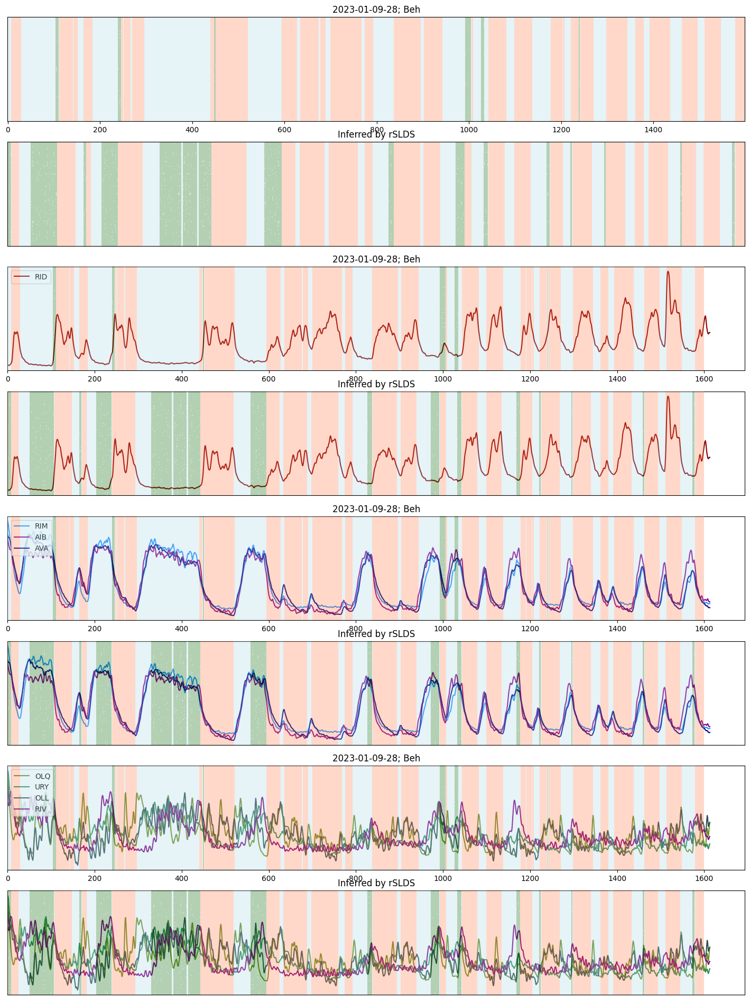

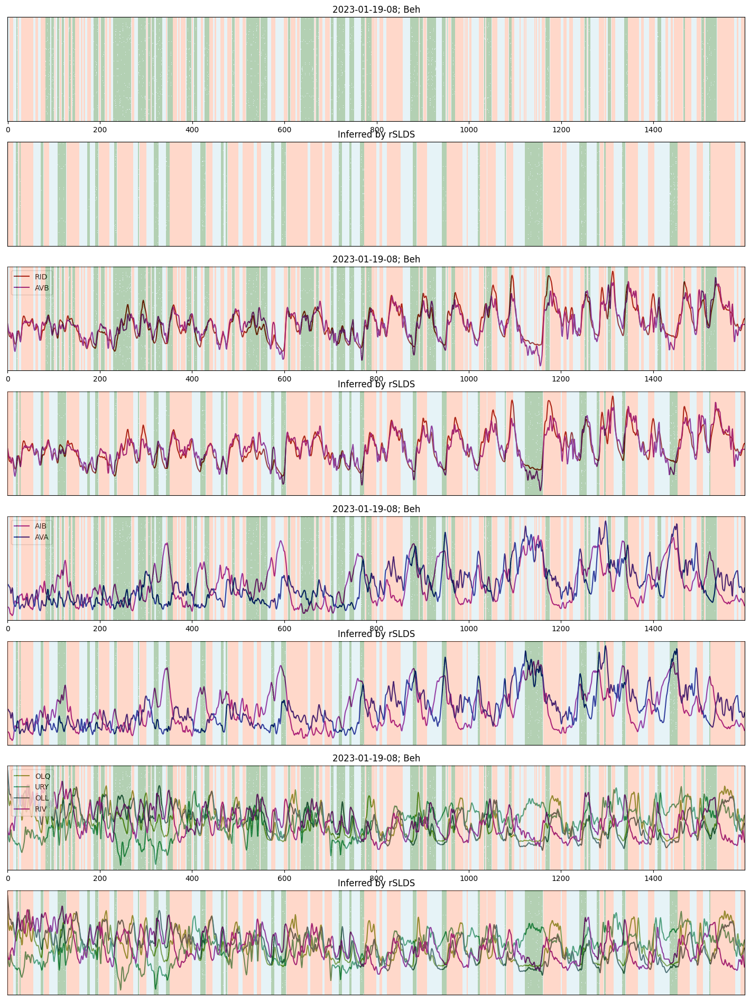

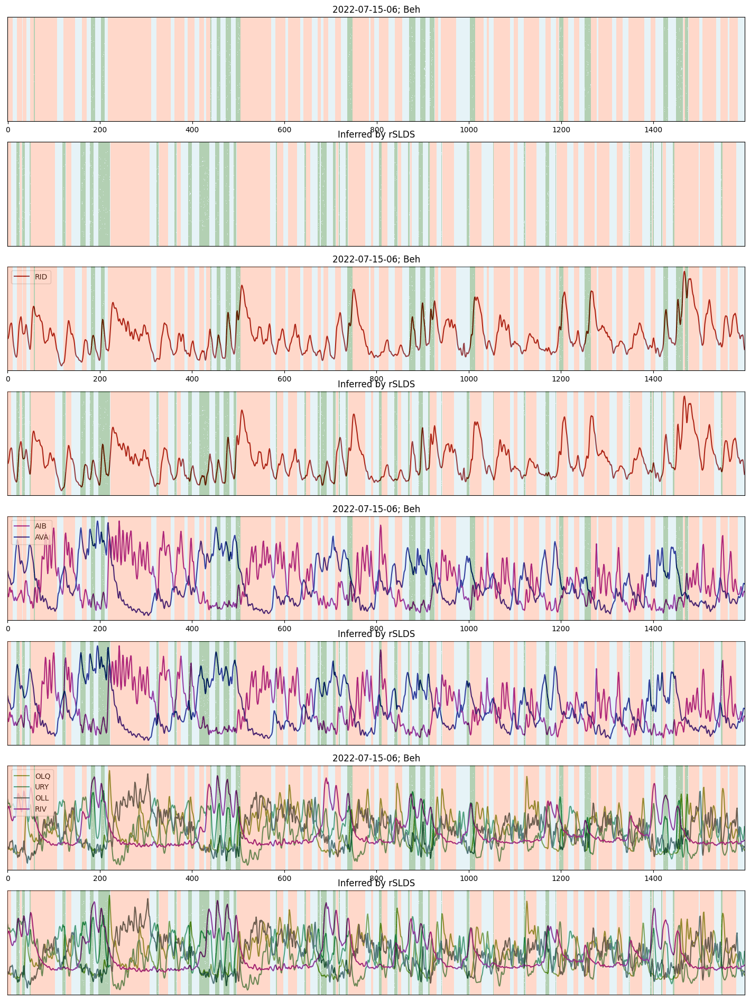

In [7]:

from rslds_visualization_utils import plot_states_and_neurons
from matplotlib.backends.backend_pdf import PdfPages
pdf_save_dir = "/Users/friederikebuck/Downloads/worm notes/rslds_all_dates/"
os.makedirs(pdf_save_dir, exist_ok=True)


#color palette for plotting, colors as in make_behavior_ethogram
palette = ["coral",     # forward
        "lightblue", # reverse
        "darkgreen", # turn
        "purple","red", "yellow", "black", "pink"]    # pause
cmap = LinearSegmentedColormap.from_list("behavior", palette, N=len(palette))
exp_dates = get_exp_dates() 
colors = ["dodgerblue", "magenta", "navy", "orange", "green"]
all_figs = []
for exp_i, (date, z_w, q_z_w, labels, traces) in enumerate(zip(exp_dates, z, q_z, full_neural_labels, full_traces)):#(len(z)):
    # Plot the true and inferred states
    
    n_sections = 4
    # fig, axs = plt.subplots(2,1, figsize=(18,6))
    fig, axs = plt.subplots(2*n_sections,1, figsize=(18,6*n_sections))
    axs[0].imshow(z_w[None,:], aspect="auto", cmap=cmap, alpha=0.3, vmin=0, vmax=len(palette))
    axs[1].imshow(q_z_w[None,:], aspect="auto", cmap=cmap, alpha=0.3, vmin=0, vmax=len(palette))
    axs[0].set_yticks([]); axs[1].set_yticks([])
    axs[0].set_title(f"{date}; Beh"); axs[1].set_title("Inferred by rSLDS")
    axs[1].set_xticks([])
    

    ###plot RID; RIB; AVB 
    neurons = ["RID", "RIB", "AVB"]
    colors = ["darkred", "crimson", "purple"]
    neuron_to_color = dict(zip(neurons, colors))
    plot_states_and_neurons(neurons, neuron_to_color, z_w, q_z_w,traces,labels, date,  fig = fig, axs = axs[2:4])
    
    
    neurons = ["RIM", "AIB", "AVA"]
    colors = ["dodgerblue", "darkmagenta", "navy"]
    neuron_to_color = dict(zip(neurons, colors))
    plot_states_and_neurons(neurons, neuron_to_color, z_w, q_z_w, traces,labels, date, fig = fig, axs = axs[4:6])
    
        
    ###plot AIY; RIM; RIB 
    neurons = ["OLQ", "URY", "OLL", "RIV"]
    colors = ["olivedrab", "seagreen", "darkslategray", "purple"]
    neuron_to_color = dict(zip(neurons, colors))
    plot_states_and_neurons(neurons, neuron_to_color, z_w, q_z_w, traces,labels, date, fig = fig, axs = axs[6:])
    
    # ###plot AIY; RIM; RIB 
    # neurons = ["AIY", "AIZ", "RIV"]
    # colors = ["darkred", "dodgerblue", "purple"]
    # neuron_to_color = dict(zip(neurons, colors))
    # plot_states_and_neurons(neurons, neuron_to_color, z_w, q_z_w)
    
    # ###plot AIY; RIM; RIB 
    # eurons = ["SMD", "SAA", "RME"]
    # colors = ["darkred", "dodgerblue", "teal"]
    # neuron_to_color = dict(zip(neurons, colors))
    # plot_states_and_neurons(neurons, neuron_to_color, z_w, q_z_w)
    all_figs.append(fig)

with PdfPages(os.path.join(pdf_save_dir,f"all_dates.pdf")) as pdf:
    for fig in all_figs: 
        pdf.savefig(fig)
        # break
    
    
    
    
    



(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none
(1599, 9)
AX is NOT none


/var/folders/8z/xy4sl8b90qnc_x9p_4psrnmh0000gn/T/ipykernel_1089/371988638.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(9, 6))  # wider to make room for square ax


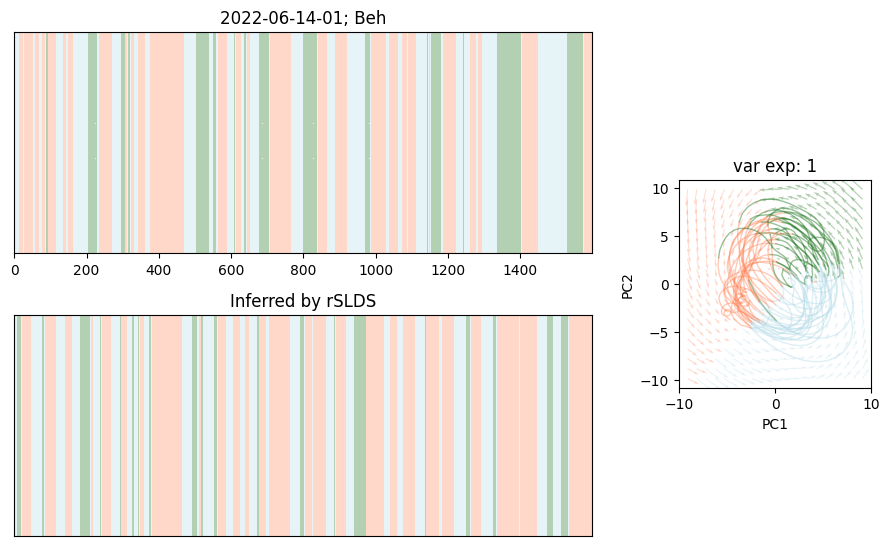

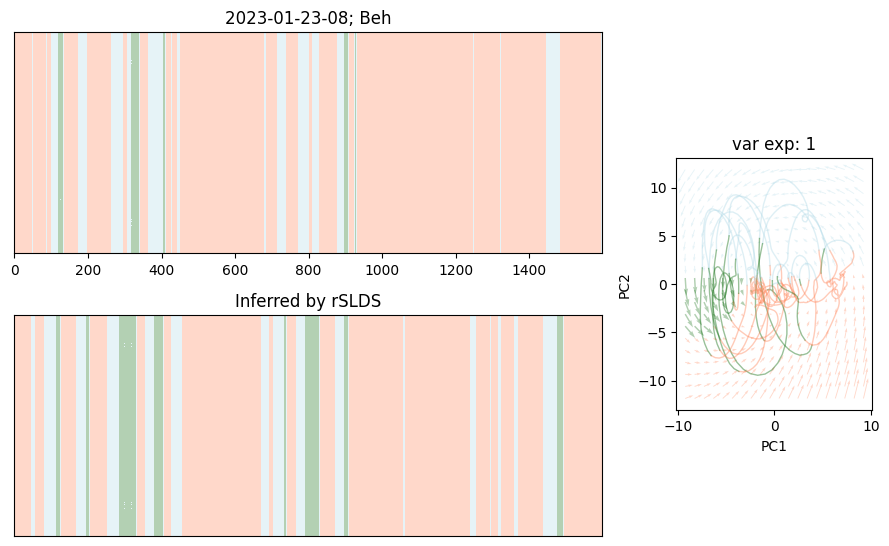

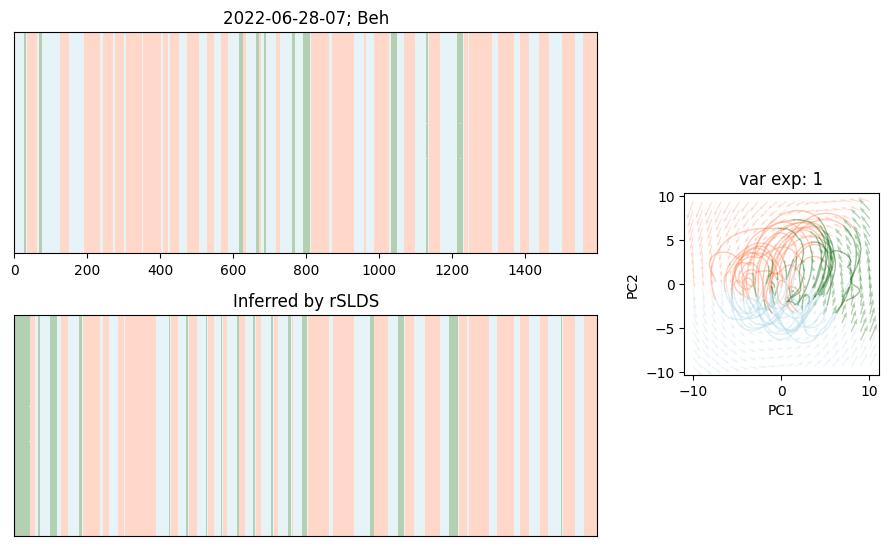

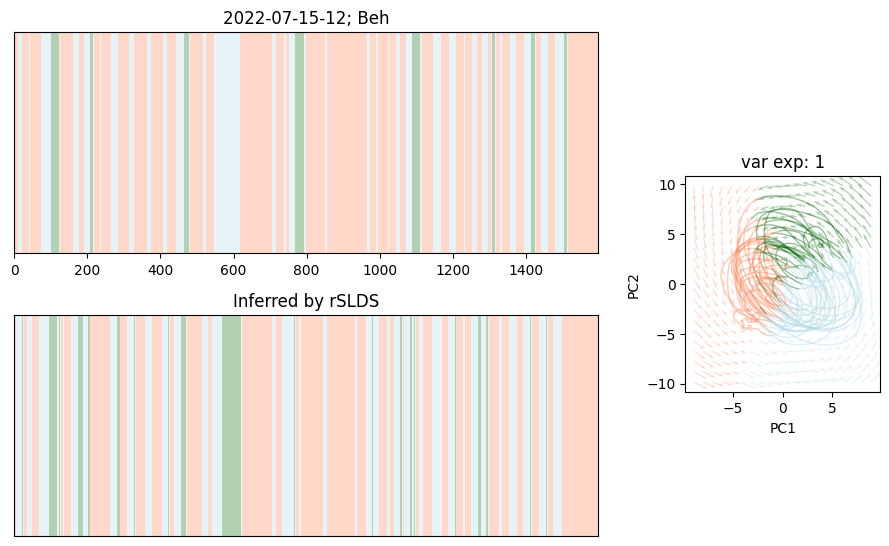

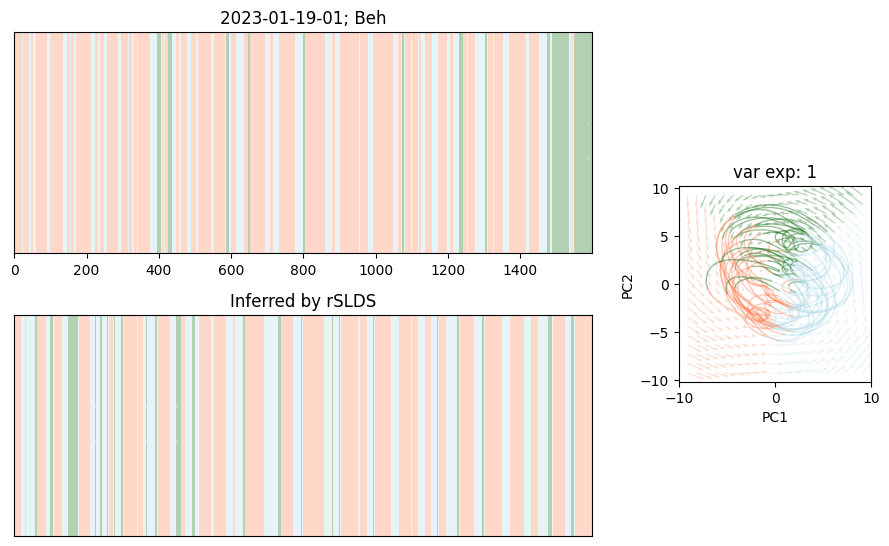

...

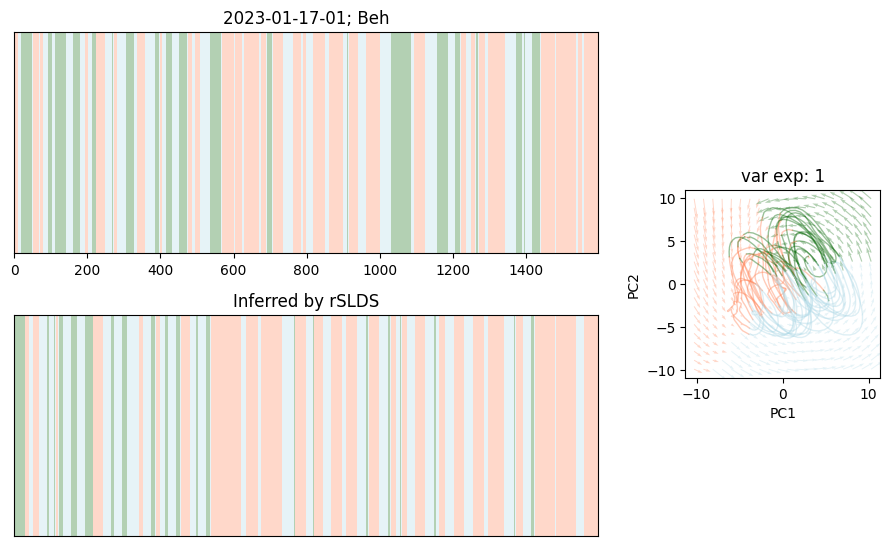

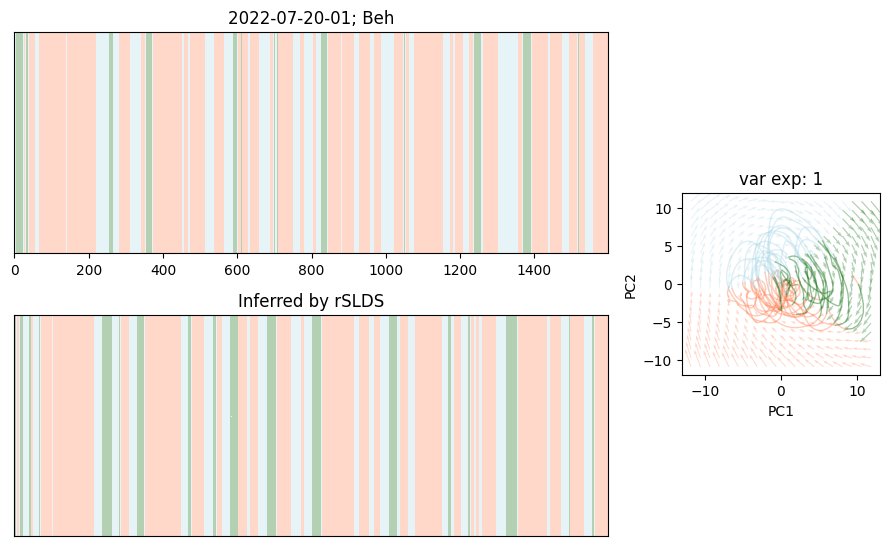

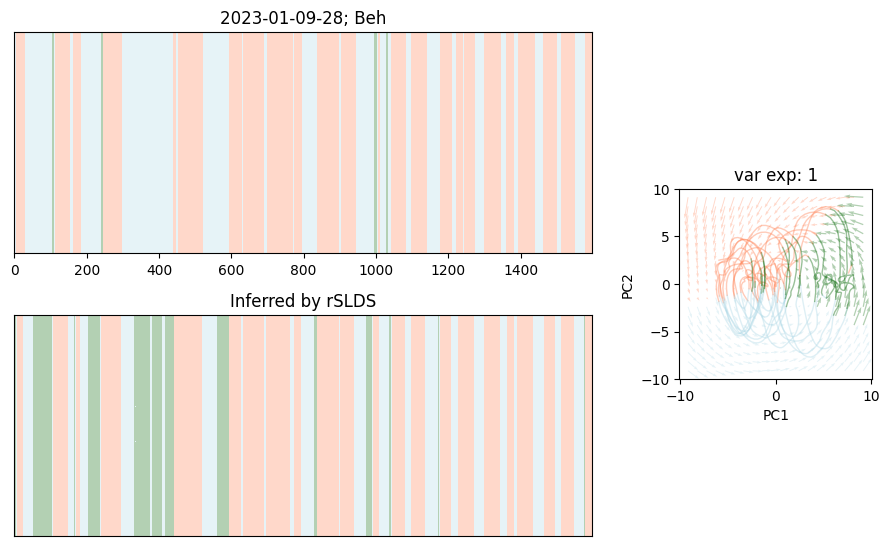

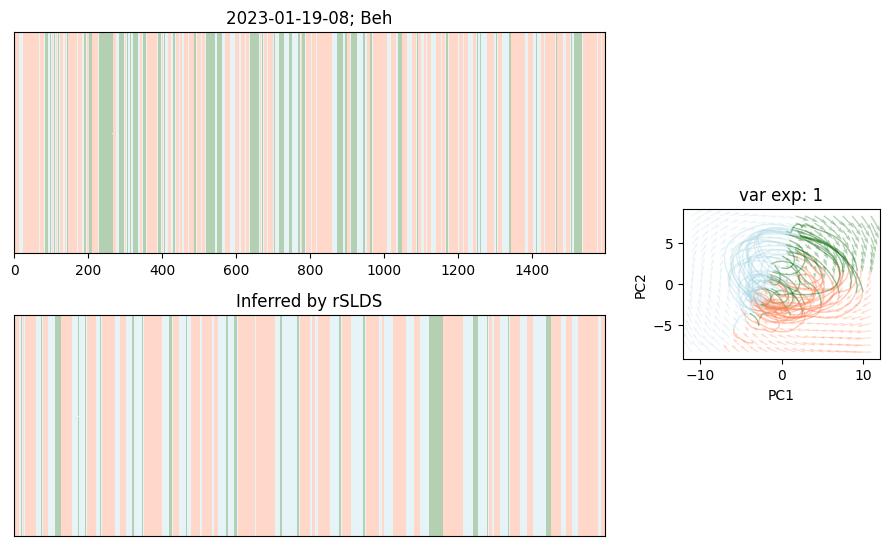

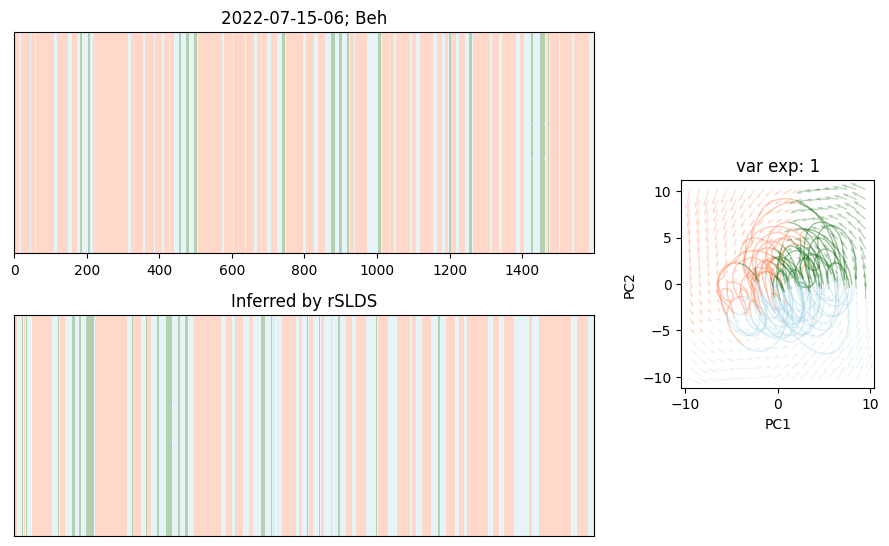

In [8]:
        
import ssm
from ssm.util import random_rotation, find_permutation

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.decomposition import PCA
    
from matplotlib.backends.backend_pdf import PdfPages
    
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import sys 

sys.path.append("/Users/friederikebuck/")

sys.path.append("/Users/friederikebuck/Desktop/MBL/project/WholeBrainImagingAnalysis/collab/")
sys.path.append('/Users/bennetsakelaris/Documents/Obsidian Vault/Worms/wormcode/Code+Notes 09-24-24/collab/')

sys.path.append("/Users/friederikebuck/Downloads/worm notes/worm_code/fit_hierarchical/")
# from rslds_utils.load_data_utils import load_all_data_but_pretend_its_all_one_worm, load_all_data
from rslds_utils.rslds_plotting_utils import plot_dynamics

emissions_dim = max(traces.shape[1] for traces in full_traces)
model = slds

# for exp_i, (z_w, q_x_w, q_z_w) in enumerate(zip(z, q_x,q_z )):#(len(z)):
#     plot_dynamics(model, q_x_w, q_z_w, z_w, 
#                   emissions_dim, 
#                   n_disc_states=3, 
#                   transition = "recurrent_only",
#                     #transition = "sticky_recurrent_only"
#                     dynamic = "diagonal_gaussian",
#                     emission = "gaussian_orthog",
#                   )





exp_dates = get_exp_dates() 
colors = ["dodgerblue", "magenta", "navy", "orange", "green"]
all_figs = []
for exp_i, (date, z_w, q_z_w, q_x_w, labels, traces) in enumerate(zip(exp_dates, z, q_z, q_x, full_neural_labels, full_traces)):#(len(z)):
    # Plot the true and inferred states

    fig = plt.figure(figsize=(9, 6))  # wider to make room for square ax
    gs = GridSpec(2, 2, width_ratios=[3, 1], height_ratios=[1, 1], figure=fig)

    # Original 2x1 vertical subplots on the left
    ax0 = fig.add_subplot(gs[0, 0])
    ax1 = fig.add_subplot(gs[1, 0])
    axs = [ax0, ax1]
    # New square subplot on the right
    
    
    n_sections = 4
    # fig, axs = plt.subplots(2,1, figsize=(18,6))
    # fig, axs = plt.subplots(2*n_sections,1, figsize=(18,6*n_sections))
    axs[0].imshow(z_w[None,:], aspect="auto", cmap=cmap, alpha=0.3, vmin=0, vmax=len(palette))
    axs[1].imshow(q_z_w[None,:], aspect="auto", cmap=cmap, alpha=0.3, vmin=0, vmax=len(palette))
    axs[0].set_yticks([]); axs[1].set_yticks([])
    axs[0].set_title(f"{date}; Beh"); axs[1].set_title("Inferred by rSLDS")
    axs[1].set_xticks([])
    ax2 = fig.add_subplot(gs[:, 1])  # spans both rows
    plot_dynamics(model, q_x_w, q_z_w, z_w, 
                emissions_dim, 
                n_disc_states=3, 
                transition = "recurrent_only",
                #transition = "sticky_recurrent_only"
                dynamic = "diagonal_gaussian",
                emission = "gaussian_orthog",
                fig = fig, 
                ax = ax2
                )
    ax2.set_aspect('equal')
    all_figs.append(fig)
pdf_save_dir = "/Users/friederikebuck/Downloads/worm notes/rslds_all_dates/"
os.makedirs(pdf_save_dir, exist_ok=True)
with PdfPages(os.path.join(pdf_save_dir,f"dyanmics_all_dates.pdf")) as pdf:
    for fig in all_figs: 
        pdf.savefig(fig)


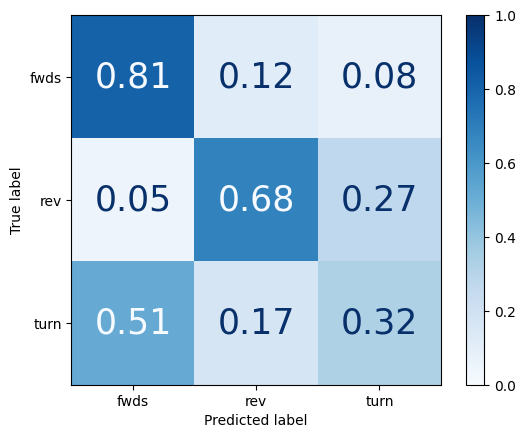

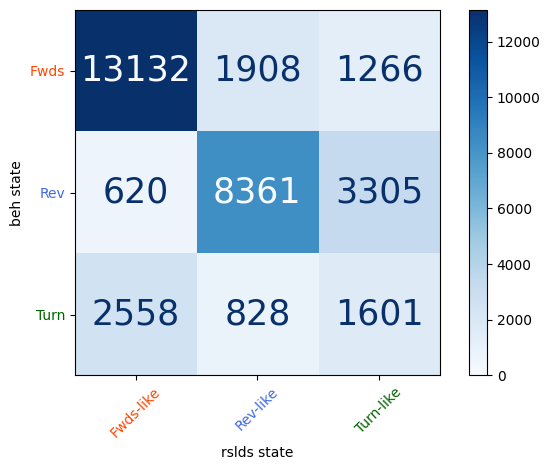

In [9]:

from sklearn.metrics import confusion_matrix #confusion_matrix(y_true, y_pred)

cm = confusion_matrix(np.concatenate(z), np.concatenate(q_z))#,  
labels=["fwds", "rev", "turn"]
# disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
# disp.plot(cmap='Blues')


# Normalize by row (true class counts)
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
# colors = ["white", "dodgerblue"]
# cmap = LinearSegmentedColormap.from_list("white_to_dodgerblue", colors)
# Display confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm_normalized, display_labels=labels)
fig, ax = plt.subplots()
im = disp.plot(cmap='Blues', values_format='.2f', text_kw={'fontsize': 25, 
                                                        #    'fontweight': 'bold'
                                                           }, ax=ax).im_

im.set_clim(0, 1)
# Your inputs
# z and q_z are lists of arrays; flatten them
cm = confusion_matrix(np.concatenate(z), np.concatenate(q_z))
labels = ["fwds", "rev", "turn"]

# Display raw counts (not normalized)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=labels)
fig, ax = plt.subplots()
im = disp.plot(cmap='Blues', values_format='d',  # 'd' = integer
               text_kw={'fontsize': 25}, ax=ax).im_
im.set_clim(0, cm.max())  
# Manually set color limits

# plt.title('Confusion Matrix (Normalized)')
true_labels = ['Fwds', 'Rev', 'Turn']
pred_labels = ['Fwds-like', 'Rev-like', 'Turn-like']
# ax.set_xticks(np.arange(len(pred_labels)))
# ax.set_xticklabels(pred_labels)
# ax.set_yticks(np.arange(len(true_labels)))
# ax.set_yticklabels(true_labels)
plt.rcParams['font.family'] = 'DejaVu Sans'
colors = [
            # "coral", 
            "orangered", 
          "royalblue",
          "darkgreen"]
ax.set_xticks(np.arange(len(pred_labels)))
ax.set_xticklabels(pred_labels, rotation=45)#, fontname='Calibri')
ax.set_xlabel("rslds state")

ax.set_yticks(np.arange(len(true_labels)))
ax.set_yticklabels(true_labels)#, fontname='Calibri')
ax.set_ylabel("beh state")

for ticklabel, color in zip(ax.get_xticklabels(), colors):
    ticklabel.set_color(color)
for ticklabel, color in zip(ax.get_yticklabels(), colors):
    ticklabel.set_color(color)
# ax.set_ylabel("")
# ax.set_xlabel("")
fig.tight_layout()

    
###Plot full confusion matrix 

# from sklearn.metrics import confusion_matrix
# # confusion_matrix(, np.concatenate(q_z))


###plot biases of all neurons 

# fig.savefig(filestr+"/rslds_figs/"+f"worm{w}_states.png")
# plt.close()
    
pdf_save_dir = "/Users/friederikebuck/Downloads/worm notes/rslds_all_dates/"
os.makedirs(pdf_save_dir, exist_ok=True)
with PdfPages(os.path.join(pdf_save_dir,f"dyanmics_all_dates.pdf")) as pdf:
    for fig in all_figs: 
        pdf.savefig(fig)

    
plt.savefig(os.path.join(pdf_save_dir,f"confusion_mat.pdf"))



# Biases - debug and uncomment at somepoint

['F - ADA' 'F - ADE' 'F - ADL' 'F - AIA' 'F - AIB' 'F - AIM' 'F - AIN'
 'F - AIY' 'F - AIZ' 'F - ALA' 'F - AQR' 'F - ASE' 'F - ASG' 'F - ASH'
 'F - ASI' 'F - AUA' 'F - AVA' 'F - AVB' 'F - AVD' 'F - AVE' 'F - AVH'
 'F - AVJ' 'F - AVK' 'F - AVL' 'F - AWA' 'F - AWB' 'F - AWC' 'F - BAG'
 'F - CEP' 'F - FLP' 'F - I1' 'F - I2' 'F - I3' 'F - I5' 'F - I6'
 'F - IL1' 'F - IL2' 'F - M1' 'F - M3' 'F - M4' 'F - M5' 'F - MC' 'F - MI'
 'F - NSM' 'F - OLL' 'F - OLQ' 'F - RIA' 'F - RIB' 'F - RIC' 'F - RID'
 'F - RIH' 'F - RIM' 'F - RIR' 'F - RIS' 'F - RIV' 'F - RMD' 'F - RME'
 'F - RMF' 'F - RMG' 'F - SAA' 'F - SIA' 'F - SIB' 'F - SMB' 'F - SMD'
 'F - URA' 'F - URB' 'F - URX' 'F - URY' 'F - VB02' 'dF - ADA' 'dF - ADE'
 'dF - ADL' 'dF - AIA' 'dF - AIB' 'dF - AIM' 'dF - AIN' 'dF - AIY'
 'dF - AIZ' 'dF - ALA' 'dF - AQR' 'dF - ASE' 'dF - ASG' 'dF - ASH'
 'dF - ASI' 'dF - AUA' 'dF - AVA' 'dF - AVB' 'dF - AVD' 'dF - AVE'
 'dF - AVH' 'dF - AVJ' 'dF - AVK' 'dF - AVL' 'dF - AWA' 'dF - AWB'
 'dF - AWC' 'dF - BA

/var/folders/8z/xy4sl8b90qnc_x9p_4psrnmh0000gn/T/ipykernel_1089/3645633750.py:181: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(["b_{0}","b_{1}", "b_{2}"],fontweight="bold",   fontsize=9);


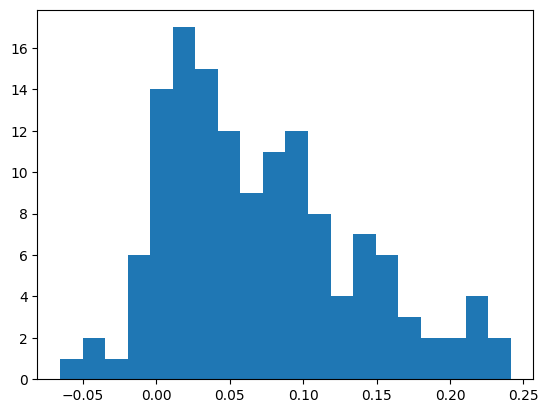

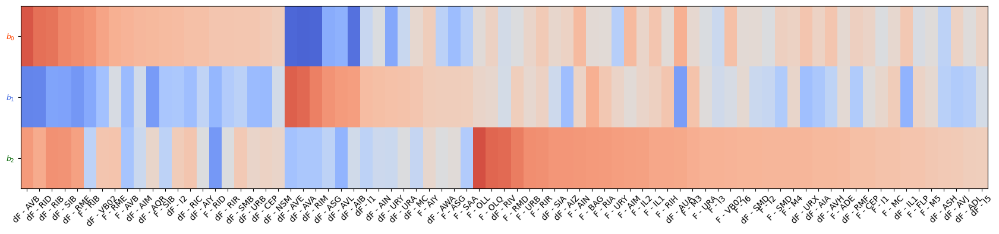

In [ ]:
# fig,ax = plt.subplots(figsize=(4,11))
# mat = slds.emissions.Cs[0]@(slds.dynamics.bs.T)/np.linalg.norm(slds.emissions.Cs[0]@(slds.dynamics.bs.T), axis=0)
# print(mat.shape)
# to_plot = slice(len(neural_labels)//2, len(neural_labels))
# to_plot = np.arange(len(neural_labels)//2, len(neural_labels))
# print(neural_labels[30], neural_labels[17])
# tmp = to_plot[30]
# to_plot[30] = to_plot[17]
# to_plot[17] = tmp
# print(to_plot)
# # AVB_i = 17
# # # start = np.arange(int(len(neural_labels)/2), int(len(neural_labels)/2)+15)
# # # end = np.arange(int(len(neural_labels)/2)+30, int(len(neural_labels)/2)+50)
# # tmp = 

# # print(neural_labels)
# # print(neural_labels[to_plot])

# # to_plot = np.concatenate([start, end]) 
# neural_labels_cropped = neural_labels[to_plot]
# mat_cropped = mat[to_plot]
# print(neural_labels_cropped)
# im = ax.imshow(mat_cropped, aspect="auto", cmap="coolwarm", vmin = -0.3, vmax=0.3)


# neurons_to_show = ["dF - RIM", "dF - AVA", "dF - AIB", "dF - RID", "dF - RIV", "dF - AVB"]
# # neuron_idxs = np.array([np.argwhere(neural_labels == neuron)[0][0] for neuron in neurons_to_show])
# neuron_idxs = np.array([np.argwhere(neural_labels_cropped == neuron)[0][0] for neuron in neurons_to_show])
# print(neuron_idxs)
# neuron_names_only = np.array([nl.split(" - ")[1] for nl in neural_labels_cropped])
# ax.set_yticks(np.arange(slds.N//2)[neuron_idxs-len(neural_labels)//2], labels=neuron_names_only[neuron_idxs], fontsize=28);
# fig.tight_layout()

# # plt.savefig("biases.pdf")
# plt.savefig("biases.png")

# # fig1,ax1 = plt.subplots(figsize=(4,11))
# # im = ax1.imshow(mat.T, aspect="auto", cmap="coolwarm", vmin = -0.3, vmax=0.3)



mat = slds.emissions.Cs[0]@(slds.dynamics.bs.T)/np.linalg.norm(slds.emissions.Cs[0]@(slds.dynamics.bs.T), axis=0)
###uncomment if only want dF
to_plot = slice(len(neural_labels)//2, len(neural_labels))
to_plot = np.arange(len(neural_labels)//2, len(neural_labels))
###
to_plot = np.arange(len(neural_labels))

'''arange by fwds sominatd rev dominated ; turn dominated '''

'''only get rows mwith high bias in at least one state'''
contributor_thres = 0.05#0.11
neural_labels_cropped = neural_labels[to_plot]
mat_cropped = mat[to_plot]
print(neural_labels_cropped)
mat_cropped = mat_cropped.T
max_contribution = np.max(mat_cropped, axis = 0)
print(max_contribution.shape)
fig, ax  = plt.subplots()
plt.hist(max_contribution, bins=20)
high_contributor_i = np.argwhere(max_contribution>contributor_thres).flatten()
# high_contributor_i = np.argwhere(max_contribution>0.11).flatten()
mat_cropped = mat_cropped[:, high_contributor_i]
neural_labels_cropped = neural_labels_cropped[high_contributor_i]





#####

# sort_is = np.argsort(mat_cropped[0,:])
# print(sort_is)
# mat_cropped = mat_cropped[:,sort_is]
# neural_labels_cropped = neural_labels_cropped[sort_is]
# print(neural_labels_cropped)
# fig,ax = plt.subplots(figsize=(11,4))
# im = ax.imshow(mat_cropped, aspect="auto", cmap="coolwarm", vmin = -0.3, vmax=0.3)

# neurons_to_show = ["dF - RIM", "dF - AVA", "dF - AIB", "dF - RID", "dF - RIV", "dF - AVB", "dF - RIB"]
# # neuron_idxs = np.array([np.argwhere(neural_labels == neuron)[0][0] for neuron in neurons_to_show])
# neuron_idxs = np.array([np.argwhere(neural_labels_cropped == neuron)[0][0] for neuron in neurons_to_show])
# print(neuron_idxs)
# neuron_names_only = np.array([nl.split(" - ")[1] for nl in neural_labels_cropped])
# ax.set_xticks(np.arange(slds.N//2)[neuron_idxs-len(neural_labels)//2], labels=neuron_names_only[neuron_idxs], rotation = 45, fontsize=28);

# neuron_to_color = {
#     "RIM":  "royalblue", 
#     "AVA": "royalblue", 
#     "AIB":  "royalblue", 
#     "RID": "orangered", 
#     "AVB": "orangered", 
#     "RIV": "darkgreen", 
#     "RIB": "orangered"
# }

# for ticklabel in ax.get_xticklabels():
#     ticklabel.set_color(neuron_to_color[ticklabel._text])
# # print(ax.get_xticklabels())
# colors = [
#             # "coral", 
#             "orangered", 
#           "royalblue",
#           "darkgreen"
#           ]

# ax.set_yticklabels(["b_{0}","b_{1}", "b_{2}"],fontweight="bold",   fontsize=28);
# true_labels = [r'$b_0$', r'$b_1$', r'$b_2$']  # LaTeX-style for subscript
# ax.set_yticks(np.arange(len(true_labels)))
# ax.set_yticklabels(true_labels)
# for ticklabel, color in zip(ax.get_yticklabels(), colors):
#     ticklabel.set_color(color)



####

chunks = []
labels = []
'''chunk into where highest bias is'''
for state in range(3):
    state_chunk = np.argmax(mat_cropped, axis = 0)


    fwds_is = np.argwhere(state_chunk == state).flatten()
    fwds_chunk = mat_cropped[:, fwds_is]
    sort_is = np.argsort(fwds_chunk[state,:])[::-1]
    fwds_chunk = fwds_chunk[:, sort_is]
    fwd_labels =neural_labels_cropped[fwds_is[sort_is]]

    chunks.append(fwds_chunk)
    labels.append(fwd_labels)
chunks = np.concatenate(chunks, axis = 1)
print("chunks.shape", chunks.shape)
labels = np.concatenate(labels)
'''sort chunks by highest bias '''
neural_labels_cropped =labels
mat_cropped = chunks




fig,ax = plt.subplots(figsize=(21,4))
im = ax.imshow(mat_cropped, aspect="auto", cmap="coolwarm", vmin = -0.3, vmax=0.3)

# neurons_to_show = ["dF - RIM", "dF - AVA", "dF - AIB", "dF - RID", "dF - RIB", "dF - RIV", "dF - AVB"]
# neuron_idxs = np.array([np.argwhere(neural_labels == neuron)[0][0] for neuron in neurons_to_show])

neuron_names_only = np.array([nl.split(" - ")[1] for nl in neural_labels_cropped])
print(neuron_names_only.shape)
####change if wnat 
# ax.set_xticks(np.arange(neural_labels_cropped.shape[0]), labels=neuron_names_only, rotation = 45, fontsize=10);
ax.set_xticks(np.arange(neural_labels_cropped.shape[0]), labels=neural_labels_cropped, rotation = 45, fontsize=10);


# ax.set_xticks(neural_labels_cropped.shape[0], neural_labels_cropped, rotation = 45, fontsize=18);

neuron_to_color = {
    "RIM":  "royalblue", 
    "AVA": "royalblue", 
    "AIB":  "royalblue", 
    "RID": "orangered", 
    "AVB": "orangered", 
    "RIV": "darkgreen", 
        "RIB": "orangered"
}

# for ticklabel in ax.get_xticklabels():
#     ticklabel.set_color(neuron_to_color[ticklabel._text])
# print(ax.get_xticklabels())
colors = [
            # "coral", 
            "orangered", 
          "royalblue",
          "darkgreen"
          ]

ax.set_yticklabels(["b_{0}","b_{1}", "b_{2}"],fontweight="bold",   fontsize=9);
true_labels = [r'$b_0$', r'$b_1$', r'$b_2$']  # LaTeX-style for subscript
ax.set_yticks(np.arange(len(true_labels)))
ax.set_yticklabels(true_labels)
for ticklabel, color in zip(ax.get_yticklabels(), colors):
    ticklabel.set_color(color)


###save labels to keep 
foldername = "/Users/friederikebuck/Downloads/worm notes/processed_checkpts/test_rslds_QM_run_061325/model_selection/top_2_combined/"
with open(os.path.join(foldername, f'high_contributing_neurons_rslds_{contributor_thres}.txt'), 'w') as f:
    for item in neural_labels_cropped:
        f.write(f"{item}\n")


In [11]:
# # fig,ax = plt.subplots(figsize=(4,11))
# # mat = slds.emissions.Cs[0]@(slds.dynamics.bs.T)/np.linalg.norm(slds.emissions.Cs[0]@(slds.dynamics.bs.T), axis=0)
# # print(mat.shape)
# # to_plot = slice(len(neural_labels)//2, len(neural_labels))
# # to_plot = np.arange(len(neural_labels)//2, len(neural_labels))
# # print(neural_labels[30], neural_labels[17])
# # tmp = to_plot[30]
# # to_plot[30] = to_plot[17]
# # to_plot[17] = tmp
# # print(to_plot)
# # # AVB_i = 17
# # # # start = np.arange(int(len(neural_labels)/2), int(len(neural_labels)/2)+15)
# # # # end = np.arange(int(len(neural_labels)/2)+30, int(len(neural_labels)/2)+50)
# # # tmp = 

# # # print(neural_labels)
# # # print(neural_labels[to_plot])

# # # to_plot = np.concatenate([start, end]) 
# # neural_labels_cropped = neural_labels[to_plot]
# # mat_cropped = mat[to_plot]
# # print(neural_labels_cropped)
# # im = ax.imshow(mat_cropped, aspect="auto", cmap="coolwarm", vmin = -0.3, vmax=0.3)


# # neurons_to_show = ["dF - RIM", "dF - AVA", "dF - AIB", "dF - RID", "dF - RIV", "dF - AVB"]
# # # neuron_idxs = np.array([np.argwhere(neural_labels == neuron)[0][0] for neuron in neurons_to_show])
# # neuron_idxs = np.array([np.argwhere(neural_labels_cropped == neuron)[0][0] for neuron in neurons_to_show])
# # print(neuron_idxs)
# # neuron_names_only = np.array([nl.split(" - ")[1] for nl in neural_labels_cropped])
# # ax.set_yticks(np.arange(slds.N//2)[neuron_idxs-len(neural_labels)//2], labels=neuron_names_only[neuron_idxs], fontsize=28);
# # fig.tight_layout()

# # # plt.savefig("biases.pdf")
# # plt.savefig("biases.png")

# # # fig1,ax1 = plt.subplots(figsize=(4,11))
# # # im = ax1.imshow(mat.T, aspect="auto", cmap="coolwarm", vmin = -0.3, vmax=0.3)



# mat = slds.emissions.Cs[0]@(slds.dynamics.bs.T)/np.linalg.norm(slds.emissions.Cs[0]@(slds.dynamics.bs.T), axis=0)
# print(mat.shape)
# to_plot = slice(len(neural_labels)//2, len(neural_labels))
# to_plot = np.arange(len(neural_labels)//2, len(neural_labels))
# # print(neural_labels[30], neural_labels[17])
# # tmp = to_plot[30]
# # to_plot[30] = to_plot[17]
# # to_plot[17] = tmp
# # print(to_plot)
# # AVB_i = 17
# # # start = np.arange(int(len(neural_labels)/2), int(len(neural_labels)/2)+15)
# # # end = np.arange(int(len(neural_labels)/2)+30, int(len(neural_labels)/2)+50)
# # tmp = 

# # print(neural_labels)
# # print(neural_labels[to_plot])

# # to_plot = np.concatenate([start, end]) 
# '''arange by fwds sominatd rev dominated ; turn dominated '''

# '''only get rows mwith high bias in at least one state'''
# # contributor_thres = 0.05#0.11
# # neural_labels_cropped = neural_labels[to_plot]
# # mat_cropped = mat[to_plot]
# # print(neural_labels_cropped)
# mat = mat.T
# # max_contribution = np.max(mat_cropped, axis = 0)
# # print(max_contribution.shape)
# # fig, ax  = plt.subplots()
# # plt.hist(max_contribution, bins=20)
# # high_contributor_i = np.argwhere(max_contribution>contributor_thres).flatten()
# # # high_contributor_i = np.argwhere(max_contribution>0.11).flatten()
# # mat_cropped = mat_cropped[:, high_contributor_i]
# # neural_labels_cropped = neural_labels_cropped[high_contributor_i]


# #####

# # sort_is = np.argsort(mat_cropped[0,:])
# # print(sort_is)
# # mat_cropped = mat_cropped[:,sort_is]
# # neural_labels_cropped = neural_labels_cropped[sort_is]
# # print(neural_labels_cropped)
# # fig,ax = plt.subplots(figsize=(11,4))
# # im = ax.imshow(mat_cropped, aspect="auto", cmap="coolwarm", vmin = -0.3, vmax=0.3)

# # neurons_to_show = ["dF - RIM", "dF - AVA", "dF - AIB", "dF - RID", "dF - RIV", "dF - AVB", "dF - RIB"]
# # # neuron_idxs = np.array([np.argwhere(neural_labels == neuron)[0][0] for neuron in neurons_to_show])
# # neuron_idxs = np.array([np.argwhere(neural_labels_cropped == neuron)[0][0] for neuron in neurons_to_show])
# # print(neuron_idxs)
# # neuron_names_only = np.array([nl.split(" - ")[1] for nl in neural_labels_cropped])
# # ax.set_xticks(np.arange(slds.N//2)[neuron_idxs-len(neural_labels)//2], labels=neuron_names_only[neuron_idxs], rotation = 45, fontsize=28);

# # neuron_to_color = {
# #     "RIM":  "royalblue", 
# #     "AVA": "royalblue", 
# #     "AIB":  "royalblue", 
# #     "RID": "orangered", 
# #     "AVB": "orangered", 
# #     "RIV": "darkgreen", 
# #     "RIB": "orangered"
# # }

# # for ticklabel in ax.get_xticklabels():
# #     ticklabel.set_color(neuron_to_color[ticklabel._text])
# # # print(ax.get_xticklabels())
# # colors = [
# #             # "coral", 
# #             "orangered", 
# #           "royalblue",
# #           "darkgreen"
# #           ]

# # ax.set_yticklabels(["b_{0}","b_{1}", "b_{2}"],fontweight="bold",   fontsize=28);
# # true_labels = [r'$b_0$', r'$b_1$', r'$b_2$']  # LaTeX-style for subscript
# # ax.set_yticks(np.arange(len(true_labels)))
# # ax.set_yticklabels(true_labels)
# # for ticklabel, color in zip(ax.get_yticklabels(), colors):
# #     ticklabel.set_color(color)



# ####
# fig,ax = plt.subplots(figsize=(11,4))
# im = ax.imshow(mat, aspect="auto", cmap="coolwarm", vmin = -0.3, vmax=0.3)
# chunks = []
# labels = []
# '''chunk into where highest bias is'''
# for state in range(3):
#     state_chunk = np.argmax(mat, axis = 0)
#     # state_chunk = np.argmax(mat_cropped, axis = 0)


#     fwds_is = np.argwhere(state_chunk == state).flatten()
#     fwds_chunk = mat[:, fwds_is]
#     sort_is = np.argsort(fwds_chunk[state,:])[::-1]
#     fwds_chunk = fwds_chunk[:, sort_is]
#     fwd_labels = neural_labels[fwds_is[sort_is]]

#     chunks.append(fwds_chunk)
#     labels.append(fwd_labels)
# all_figs = []
# for label, chunk in zip(labels, chunks):
#     fig,ax = plt.subplots(figsize=(16,5))
#     im = ax.imshow(chunk, aspect="auto", cmap="coolwarm", vmin = -0.3, vmax=0.3)
#     neuron_names_only = np.array([nl.split(" - ")[1] for nl in neural_labels_cropped])
#     print(neuron_names_only.shape)
#     # ax.set_xticks(np.arange(slds.N//2)[neuron_idxs-len(neural_labels)//2], labels=neuron_names_only[neuron_idxs], rotation = 45, fontsize=28);
#     ax.set_xticks(np.arange(len(label)), labels=label, rotation = 65, fontsize=9);
#     all_figs.append(fig)

# pdf_save_dir = "/Users/friederikebuck/Downloads/worm notes/rslds_all_dates/"
# os.makedirs(pdf_save_dir, exist_ok=True)
# with PdfPages(os.path.join(pdf_save_dir,f"baises.pdf")) as pdf:
#     for fig in all_figs: 
#         pdf.savefig(fig)     

# chunks = np.concatenate(chunks, axis = 1)
# print("chunks.shape", chunks.shape)
# labels = np.concatenate(labels)
# '''sort chunks by highest bias '''
# neural_labels_cropped =labels
# mat_cropped = chunks


# fig,ax = plt.subplots(figsize=(11,4))
# im = ax.imshow(mat_cropped, aspect="auto", cmap="coolwarm", vmin = -0.3, vmax=0.3)

# neurons_to_show = ["dF - RIM", "dF - AVA", "dF - AIB", "dF - RID", "dF - RIB", "dF - RIV", "dF - AVB"]
# # neuron_idxs = np.array([np.argwhere(neural_labels == neuron)[0][0] for neuron in neurons_to_show])

# neuron_names_only = np.array([nl.split(" - ")[1] for nl in neural_labels_cropped])
# print(neuron_names_only.shape)
# # ax.set_xticks(np.arange(slds.N//2)[neuron_idxs-len(neural_labels)//2], labels=neuron_names_only[neuron_idxs], rotation = 45, fontsize=28);
# ax.set_xticks(np.arange(neural_labels_cropped.shape[0]), labels=neuron_names_only, rotation = 45, fontsize=10);


# # ax.set_xticks(neural_labels_cropped.shape[0], neural_labels_cropped, rotation = 45, fontsize=18);

# # neuron_to_color = {
# #     "RIM":  "royalblue", 
# #     "AVA": "royalblue", 
# #     "AIB":  "royalblue", 
# #     "RID": "orangered", 
# #     "AVB": "orangered", 
# #     "RIV": "darkgreen", 
# #         "RIB": "orangered"
# # }

# # for ticklabel in ax.get_xticklabels():
# #     ticklabel.set_color(neuron_to_color[ticklabel._text])
# # print(ax.get_xticklabels())
# colors = [
#             # "coral", 
#             "orangered", 
#           "royalblue",
#           "darkgreen"
#           ]

# ax.set_yticklabels(["b_{0}","b_{1}", "b_{2}"],fontweight="bold",   fontsize=10);
# true_labels = [r'$b_0$', r'$b_1$', r'$b_2$']  # LaTeX-style for subscript
# ax.set_yticks(np.arange(len(true_labels)))
# ax.set_yticklabels(true_labels)
# for ticklabel, color in zip(ax.get_yticklabels(), colors):
#     ticklabel.set_color(color)
